<a href="https://colab.research.google.com/github/raheymakhan/Paper/blob/main/Time_Frame_02.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Time Frame 02: From Election 2020 Till Vaccine Approval

### <u>DATA PREPARATION</u>

##### SETTING UP THE TWITTER API

In [ ]:
import os
import tweepy as tw
import pandas as pd

consumer_key = 'qWaI6kizU7SAcRNc6EnnoNChq'
consumer_secret = 'xumE7NgIZMiLCUXFeEl0pr3zhsuqdLvOPB0tG94HBQ8PgP2vsK'
access_token = '2747565082-8g1OYC9aFI4NxRInAV5ArxV1te4V6alDLHlQuNn'
access_token_secret = 'rDMmFApw3H5vL5KqVRxwRKdmJCkRdmrqjG8CCfmVroNKV'

auth = tw.OAuthHandler(consumer_key, consumer_secret)
auth.set_access_token(access_token, access_token_secret)
api = tw.API(auth, wait_on_rate_limit=True)

##### PREPARING THE COVID-19 VACCINE TWEETS DATASET (the dataset from election 2020 till vaccine approval day i.e. Nov 02 till Dec 11)

In [ ]:
'''
We are using 'snscrape' to collect the tweets.
For this package we will have to run the following commands in the command prompt/anaconda prompt of our computers:

snscrape twitter-search "#covid-19vaccine since:2020-11-02 until:2020-12-12" > frame2_tweets1.txt
snscrape twitter-search "#COVID-19Vaccine since:2020-11-02 until:2020-12-12" > frame2_tweets2.txt
snscrape twitter-search "#covidvaccine since:2020-11-02 until:2020-12-12" > frame2_tweets3.txt
snscrape twitter-search "#coronavirusvaccine since:2020-11-02 until:2020-12-12" > frame2_tweets4.txt
snscrape twitter-search "#coronavaccine since:2020-11-02 until:2020-12-12" > frame2_tweets5.txt

Each command is run separately in the prompt and returns URL ids for the tweets in a text file.
Then we will use the following commands to extract the URL ids and finally the tweet texts from the text files.

Reference: https://medium.com/@jcldinco/downloading-historical-tweets-using-tweet-ids-via-snscrape-and-tweepy-5f4ecbf19032
'''

# Converting the text files into a single pandas dataframe.
tweet_url = pd.read_csv(r"C:\Users\Raheyma Arshad\Desktop\Covid Paper\Time Frame 02\frame2_tweets1.txt", index_col= None, header = None, names = ["links"])
tweet_url2 = pd.read_csv(r"C:\Users\Raheyma Arshad\Desktop\Covid Paper\Time Frame 02\frame2_tweets2.txt", index_col= None, header = None, names = ["links"])
tweet_url3 = pd.read_csv(r"C:\Users\Raheyma Arshad\Desktop\Covid Paper\Time Frame 02\frame2_tweets3.txt", index_col= None, header = None, names = ["links"])
tweet_url4 = pd.read_csv(r"C:\Users\Raheyma Arshad\Desktop\Covid Paper\Time Frame 02\frame2_tweets4.txt", index_col= None, header = None, names = ["links"])
tweet_url5 = pd.read_csv(r"C:\Users\Raheyma Arshad\Desktop\Covid Paper\Time Frame 02\frame2_tweets5.txt", index_col= None, header = None, names = ["links"])

tweet_url = tweet_url.append(tweet_url2, ignore_index=True)
tweet_url = tweet_url.append(tweet_url3, ignore_index=True)
tweet_url = tweet_url.append(tweet_url4, ignore_index=True)
tweet_url = tweet_url.append(tweet_url5, ignore_index=True)

# Splitting the URLs and getting the id of each tweet.
tweet_url['id'] = tweet_url.apply(lambda x: x["links"].split("/")[-1], axis=1)
# Saving the tweet ids in a list.
ids = tweet_url['id'].tolist()

# Defining function to get the text from each tweet.
def tweet_text(ids):
    tweet_status_list = api.statuses_lookup(ids, tweet_mode= "extended")
    text = pd.DataFrame()
    for status in tweet_status_list:
            tweet_text = {"tweet":status.full_text, "location": status.user.location}
            text = text.append(tweet_text, ignore_index = True)
    text.to_csv(r"C:\Users\Raheyma Arshad\Desktop\Covid Paper\Time Frame 02\Vaccine Tweets (Time Frame 02).csv", mode="a")
    
# We divide our tweet ids into batches and run the above function on each batch. (Running on all the tweets ids together 
# raises error)
ids_count = len(ids)
batches = (ids_count - 1) // 50 + 1

for i in range(batches):
        batch = ids[i*50:(i+1)*50]
        result = tweet_text(batch)
        
covid_vaccine_data = pd.read_csv(r"C:\Users\Raheyma Arshad\Desktop\Covid Paper\Time Frame 02\Vaccine Tweets (Time Frame 02).csv")
del covid_vaccine_data['Unnamed: 0']
covid_vaccine_data = covid_vaccine_data[covid_vaccine_data.tweet != 'tweet']
covid_vaccine_data.head()

,location,tweet
0,RNA World,'Accelerate development and distribution of......
1,"Victoria, Australia",Because it is devastating for the pharma compa...
2,USA,@timwilliamsart I trust science. I trust mede...
3,Bangalore,'ಕ್ಯೂರ್‌ ವಾಕ್‌' ಪ್ರಾಯೋಗಿಕ ಲಸಿಕೆಯಿಂದ ಮಾನವರಲ್ಲಿ ...
4,manchester England,❌ It will be the #flu jab first then the #covi...


##### TRANSLATING THE COVID-19 VACCINE TWEETS DATASET

In [ ]:
import os
os.environ['GOOGLE_APPLICATION_CREDENTIALS'] = r"C:\Users\Raheyma Arshad\Desktop\Covid Paper\project01-cb3f386c496f.json"

translated_tweets = []

def translate_text(target, tweet_list):
    import six
    from google.cloud import translate_v2 as translate
    translate_client = translate.Client()
    
    for text in tweet_list:
        if not text:
            translated_tweets.append("")
        elif len(text) < 4:
            translated_tweets.append("")
        else:
            if isinstance(text, six.binary_type):
                text = text.decode("utf-8")
    
            result = translate_client.translate(text, target_language=target)
            translated_tweets.append(u"{}".format(result["translatedText"]))

def chunkIt(seq, num):
    avg = len(seq) / float(num)
    out = []
    last = 0.0
    while last < len(seq):
        out.append(seq[int(last):int(last + avg)])
        last += avg
    return out

tweets_list = covid_vaccine_data['tweet'].values.tolist()
tweets_sublists = chunkIt(tweets_list, 20)

for i in range(20):
    translate_text('en', tweets_sublists[i])
    
covid_vaccine_data['Translated Tweet'] = translated_tweets
covid_vaccine_data.head()    

,location,tweet,Translated Tweet
0,RNA World,'Accelerate development and distribution of......,'Accelerate development and distribution of......
1,"Victoria, Australia",Because it is devastating for the pharma compa...,Because it is devastating for the pharma compa...
2,USA,@timwilliamsart I trust science. I trust mede...,@timwilliamsart I trust science. I trust mede...
3,Bangalore,'ಕ್ಯೂರ್‌ ವಾಕ್‌' ಪ್ರಾಯೋಗಿಕ ಲಸಿಕೆಯಿಂದ ಮಾನವರಲ್ಲಿ ...,The Cure Walk clinical vaccine has boosted imm...
4,manchester England,❌ It will be the #flu jab first then the #covi...,❌ It will be the #flu jab first then the #covi...


##### CLEANING AND PREPROCESSING THE COVID-19 VACCINE TWEETS DATASET

In [ ]:
import re
from nltk.stem.porter import PorterStemmer
from nltk.corpus import stopwords
from textblob import TextBlob
from googletrans import Translator
translator = Translator()
stop = stopwords.words('english')

def preprocess_word(tweet):
    processed_tweet = []
    words = tweet.split()
    for word in words:
        # Removing punctuation
        word = word.strip('\'"?!,.():;') 
        # Converting more than 2 letter repetitions to 2 letter e.g. funnnnny --> funny
        word = re.sub(r'(.)\1+', r'\1\1', word)  
        # Removing - & '
        word = re.sub(r'(-|\')', '', word)       
        processed_tweet.append(word)
    return ' '.join(processed_tweet)
    
covid_vaccine_data['Clean Tweet'] = covid_vaccine_data['Translated Tweet'].apply(lambda x: preprocess_word(x))

def is_valid_word(tweet):
    processed_tweet = []
    words = tweet.split()
    for word in words:
        # Checking if word begins with an alphabet
        if re.search(r'^[a-zA-Z][a-z0-9A-Z\._]*$', word) is not None:
            processed_tweet.append(word)
    return ' '.join(processed_tweet)

covid_vaccine_data['Clean Tweet'] = covid_vaccine_data['Clean Tweet'].apply(lambda x: is_valid_word(x))

def handle_emojis(tweet):
    # Smile -- :), : ), :-), (:, ( :, (-:, :')
    tweet = re.sub(r'(:\s?\)|:-\)|\(\s?:|\(-:|:\'\))', ' EMO_POS ', tweet)
    # Laugh -- :D, : D, :-D, xD, x-D, XD, X-D
    tweet = re.sub(r'(:\s?D|:-D|x-?D|X-?D)', ' EMO_POS ', tweet)
    # Love -- <3, :*
    tweet = re.sub(r'(<3|:\*)', ' EMO_POS ', tweet)
    # Wink -- ;-), ;), ;-D, ;D, (;,  (-;
    tweet = re.sub(r'(;-?\)|;-?D|\(-?;)', ' EMO_POS ', tweet)
    # Sad -- :-(, : (, :(, ):, )-:
    tweet = re.sub(r'(:\s?\(|:-\(|\)\s?:|\)-:)', ' EMO_NEG ', tweet)
    # Cry -- :,(, :'(, :"(
    tweet = re.sub(r'(:,\(|:\'\(|:"\()', ' EMO_NEG ', tweet)
    return tweet

covid_vaccine_data['Clean Tweet'] = covid_vaccine_data['Clean Tweet'].apply(lambda x: handle_emojis(x))

def preprocess_tweet(tweet):
    porter_stemmer = PorterStemmer()
    # Lower-casing
    tweet = tweet.lower()
    # Removing non-ascii characters i.e. characters with ascii value >= 128
    tweet = ''.join([w if ord(w) < 128 else ' ' for w in tweet])
    # Spelling correction
    tweet = str(TextBlob(tweet).correct())
    # Replacing URLs with the word URL
    tweet = re.sub(r'((www\.[\S]+)|(https?://[\S]+))', ' URL ', tweet)
    # Replacing @handle with the word USER_MENTION
    tweet = re.sub(r'@[\S]+', 'USER_MENTION', tweet)
    # Replacing #hashtag with hashtag
    tweet = re.sub(r'#(\S+)', r' \1 ', tweet)
    # Removing RT (retweet)
    tweet = re.sub(r'\brt\b', '', tweet)
    # Replacing 2+ dots with space
    tweet = re.sub(r'\.{2,}', ' ', tweet)
    # Stripping space, " and ' from tweet
    tweet = tweet.strip(' "\'')
    # Replacing multiple spaces with a single space
    tweet = re.sub(r'\s+', ' ', tweet)
    # Removing stop words
    processed_tweet = []
    words = tweet.split()
    for word in words:
        if word not in stop:
            processed_tweet.append(word)
    return ' '.join(processed_tweet)

covid_vaccine_data['Clean Tweet'] = covid_vaccine_data['Clean Tweet'].apply(lambda x: preprocess_tweet(x))

covid_vaccine_data = covid_vaccine_data.dropna(subset=['Clean Tweet'])
covid_vaccine_data = covid_vaccine_data.reset_index()
del covid_vaccine_data['index']

# Removing empty rows
covid_vaccine_data['Clean Tweet'].replace("", np.nan, inplace=True)
covid_vaccine_data.dropna(subset=['Clean Tweet'], inplace=True)
covid_vaccine_data.head()

,location,tweet,Translated Tweet,Clean Tweet
0,RNA World,'Accelerate development and distribution of......,'Accelerate development and distribution of......,accelerate development distribution vaccines e...
1,"Victoria, Australia",Because it is devastating for the pharma compa...,Because it is devastating for the pharma compa...,devastating parma companies vaccine
2,USA,@timwilliamsart I trust science. I trust mede...,@timwilliamsart I trust science. I trust mede...,trust science trust medicine provaccination gr...
3,Bangalore,'ಕ್ಯೂರ್‌ ವಾಕ್‌' ಪ್ರಾಯೋಗಿಕ ಲಸಿಕೆಯಿಂದ ಮಾನವರಲ್ಲಿ ...,The Cure Walk clinical vaccine has boosted imm...,cure walk clinical vaccine boasted immunity hu...
4,manchester England,❌ It will be the #flu jab first then the #covi...,❌ It will be the #flu jab first then the #covi...,jaw first children guinea pigs could


### <u>SENTIMENT ANALYSIS</u>

In [ ]:
from transformers import BertForPreTraining

from transformers import pipeline
classifier = pipeline('sentiment-analysis')
covid_vaccine_data['Sentiment'] = covid_vaccine_data['Clean Tweet'].apply(lambda x: classifier(x))

def get_label(x):
    x = str(x)
    if 'POSITIVE' in x:
        return 'Positive'
    if 'NEGATIVE' in x:
        return 'Negative'

covid_vaccine_data['Sentiment'] = covid_vaccine_data['Sentiment'].apply(lambda x: get_label(x))
covid_vaccine_data.head()

C:\Raheyma\Software\Anaconda\lib\site-packages\torch\cuda\__init__.py:52: UserWarning: CUDA initialization: Found no NVIDIA driver on your system. Please check that you have an NVIDIA GPU and installed a driver from http://www.nvidia.com/Download/index.aspx (Triggered internally at  ..\c10\cuda\CUDAFunctions.cpp:100.)
  return torch._C._cuda_getDeviceCount() > 0


,location,tweet,Translated Tweet,Clean Tweet,Sentiment
0,RNA World,'Accelerate development and distribution of......,'Accelerate development and distribution of......,accelerate development distribution vaccines e...,Positive
1,"Victoria, Australia",Because it is devastating for the pharma compa...,Because it is devastating for the pharma compa...,devastating parma companies vaccine,Negative
2,USA,@timwilliamsart I trust science. I trust mede...,@timwilliamsart I trust science. I trust mede...,trust science trust medicine provaccination gr...,Negative
3,Bangalore,'ಕ್ಯೂರ್‌ ವಾಕ್‌' ಪ್ರಾಯೋಗಿಕ ಲಸಿಕೆಯಿಂದ ಮಾನವರಲ್ಲಿ ...,The Cure Walk clinical vaccine has boosted imm...,cure walk clinical vaccine boasted immunity hu...,Negative
4,manchester England,❌ It will be the #flu jab first then the #covi...,❌ It will be the #flu jab first then the #covi...,jaw first children guinea pigs could,Negative


<AxesSubplot:xlabel='Sentiment', ylabel='count'>

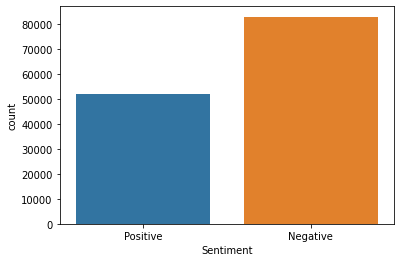

In [ ]:
# Plotting the distribution of sentiments
import seaborn as sns
import matplotlib as plt
sns.countplot(covid_vaccine_data['Sentiment'])

### <u>KEYWORD EXTRACTION</u>

In [ ]:
# Removing frequent words
high_freq = pd.Series(' '.join(covid_vaccine_data['Clean Tweet']).split()).value_counts()[:20]
high_freq = list(high_freq.index)
covid_vaccine_data['Clean Tweet'] = covid_vaccine_data['Clean Tweet'].apply(lambda x: " ".join(x for x in x.split() if x not in high_freq))

# Separating positive and negative tweets and keeping them in dataframes

df_positive = covid_vaccine_data[covid_vaccine_data['Sentiment'] == 'Positive'] 
df_negative = covid_vaccine_data[covid_vaccine_data['Sentiment'] == 'Negative'] 

##### POSITIVE TWEETS

In [ ]:
import yake
positive_tweets = df_positive['Clean Tweet'].to_list()
positive_text = ' '.join(positive_tweets)

language = "en"
max_ngram_size = 3
deduplication_thresold = 0.9
deduplication_algo = 'seqm'
windowSize = 1
numOfKeywords = 50

custom_kw_extractor = yake.KeywordExtractor(lan=language, n=max_ngram_size, dedupLim=deduplication_thresold, dedupFunc=deduplication_algo, windowsSize=windowSize, top=numOfKeywords, features=None)
positive_keywords = custom_kw_extractor.extract_keywords(positive_text)

for kw in positive_keywords:
    print(kw)

(1.138436019904642e-06, 'rushing distractions')
(1.323936855630166e-06, 'postpone completely')
(1.7541017794937227e-06, 'entire without rushing')
(2.2332299064737895e-06, 'completely since entire')
(4.529235055778247e-06, 'good medical clinical')
(6.552403904126405e-06, 'clinical research join')
(6.571974117571906e-06, 'minister narendra mode')
(6.844720982540192e-06, 'medical clinical research')
(7.0531708504359115e-06, 'prime minister narendra')
(1.0527140059200702e-05, 'loved receive coming')
(1.103057417384624e-05, 'great day science')
(1.1285691407607402e-05, 'raging loved receive')
(1.172437163751806e-05, 'join good medical')
(1.1756687995777708e-05, 'receive coming raging')
(1.2665326439106762e-05, 'research join good')
(1.2767937435445355e-05, 'country approve')
(1.2775190635853961e-05, 'coming raging loved')
(1.300145484522337e-05, 'light end tunnel')
(1.3182550690376741e-05, 'prime minister mode')
(1.464546446987199e-05, 'today good day')
(1.660206957001961e-05, 'prime minist

##### NEGATIVE TWEETS

In [ ]:
negative_tweets = df_negative['Clean Tweet'].to_list()
negative_text = ' '.join(negative_tweets)

language = "en"
max_ngram_size = 3
deduplication_thresold = 0.9
deduplication_algo = 'seqm'
windowSize = 1
numOfKeywords = 50

custom_kw_extractor = yake.KeywordExtractor(lan=language, n=max_ngram_size, dedupLim=deduplication_thresold, dedupFunc=deduplication_algo, windowsSize=windowSize, top=numOfKeywords, features=None)
negative_keywords = custom_kw_extractor.extract_keywords(negative_text)

for kw in negative_keywords:
    print(kw)

(1.6729970953483377e-06, 'recorded song live')
(1.8389387229675549e-06, 'buy safe home')
(1.942909344513952e-06, 'song live lead')
(2.270526841541432e-06, 'safe home hanna')
(2.2990937171255855e-06, 'prime minister mode')
(2.3309053160175562e-06, 'original song anaemic')
(2.385708928128462e-06, 'song anaemic isolated')
(2.414865434023005e-06, 'minister narendra mode')
(2.6841813040045973e-06, 'lines fighting virus')
(2.7732803478704587e-06, 'side effects')
(2.950693498521715e-06, 'recorded original song')
(3.043457489744982e-06, 'isolated recorded song')
(3.2754518273131257e-06, 'tracks song dedicated')
(3.3575678546924332e-06, 'sale buy safe')
(3.3657318915719137e-06, 'backing tracks song')
(3.474288104710415e-06, 'front lines fighting')
(3.5558978545480623e-06, 'anaemic isolated recorded')
(3.699910709204355e-06, 'long term effects')
(4.064174765193961e-06, 'serum institute pure')
(4.205365608864498e-06, 'prime minister narendra')
(5.055262374735394e-06, 'live lead guitar')
(5.150799

### <u>TOPIC MODELING</u>

##### POSITIVE TWEETS

In [ ]:
#from bertopic import BERTopic

#positive_tweets = df_positive['Clean Tweet'].tolist()
#positive_tweets = [str(i) for i in positive_tweets]

#model = BERTopic(language="english")
#topics, probs = model.fit_transform(positive_tweets)
#model.update_topics(positive_tweets, topics, n_gram_range=(1, 3))

print('The 10 most frequent topics in positive tweets are:','\n')
print(model.get_topic_freq().head(11))
print('\n')

print('Topic 01:', model.get_topic(1)[:10],'\n')
print('Topic 02:', model.get_topic(4)[:10],'\n')
print('Topic 03:', model.get_topic(446)[:10],'\n')
print('Topic 04:', model.get_topic(1270)[:10],'\n')
print('Topic 05:', model.get_topic(390)[:10],'\n')
print('Topic 06:', model.get_topic(182)[:10],'\n')
print('Topic 07:', model.get_topic(1231)[:10],'\n')
print('Topic 08:', model.get_topic(534)[:10],'\n')
print('Topic 09:', model.get_topic(70)[:10],'\n')
print('Topic 10:', model.get_topic(710)[:10],'\n')

model.visualize_topics()

The 10 most frequent topics in positive tweets are: 

    Topic  Count
0      -1  10614
1       1   1165
2       4    669
3     446    258
4    1270    252
5     390    238
6     182    183
7    1231    168
8     534    161
9      70    156
10    710    152


Topic 01: [('everyone compassion hello', 0.00034479821324780787), ('time lives without', 0.00034479821324780787), ('distractions thank best', 0.00034479821324780787), ('everyone compassion', 0.00034479821324780787), ('compassion hello please', 0.00034479821324780787), ('compassion hello', 0.00034479821324780787), ('judgment meeting everyone', 0.00034479821324780787), ('meeting everyone compassion', 0.00034479821324780787), ('compassion', 0.0002190736930443221), ('considered entire without', 0.0001922299417613727)] 

Topic 02: [('free service delivery', 0.0), ('free shaping beautifully', 0.0), ('free share', 0.0), ('free share friends', 0.0), ('free share rolled', 0.0), ('free share thoughts', 0.0), ('free social', 0.0), ('free soc

##### NEGATIVE TWEETS

In [ ]:
negative_tweets = df_negative['Clean Tweet'].tolist()
negative_tweets = [str(i) for i in negative_tweets]

model = BERTopic(language="english")
topics, probs = model.fit_transform(negative_tweets)
model.update_topics(negative_tweets, topics, n_gram_range=(1, 3))

print('The 10 most frequent topics in negative tweets are:','\n')
print(model.get_topic_freq().head(11))
print('\n')

#print('Topic 01:', model.get_topic(0)[:10],'\n')
#print('Topic 02:', model.get_topic(409)[:10],'\n')
#print('Topic 03:', model.get_topic(270)[:10],'\n')
#print('Topic 04:', model.get_topic(11)[:10],'\n')
#print('Topic 05:', model.get_topic(944)[:10],'\n')
#print('Topic 06:', model.get_topic(343)[:10],'\n')
#print('Topic 07:', model.get_topic(281)[:10],'\n')
#print('Topic 08:', model.get_topic(52)[:10],'\n')
#print('Topic 09:', model.get_topic(1148)[:10],'\n')
#print('Topic 10:', model.get_topic(411)[:10],'\n')

#model.visualize_topics()

### <u>ANALYZING SENTIMENTS IN DIFFERENT COUNTRIES AND COMPARING TO NO. OF REPORTED CASES</u>

##### GETTING COUNTRY OF EACH TWEET

In [ ]:
# Getting country of each tweet

from geopy.geocoders import Nominatim

def get_country(x):       
    geolocator = Nominatim(user_agent = "geoapiExercises")
    location = geolocator.geocode(x)
    return str(location).rsplit(', ')[-1]

locations = covid_vaccine_data['location'].unique().tolist()
countries = []

for location in locations:
    try:
        countries.append(get_country(location))
    except:
        countries.append('Country Not Recognized')
        
dict_1 = dict(zip(locations, countries))
covid_vaccine_data['Country'] = covid_vaccine_data['location'].map(dict_1)
covid_vaccine_data['Country'] = covid_vaccine_data['Country'].apply(lambda x: x.replace('United States of America', 'United States'))
covid_vaccine_data = covid_vaccine_data[covid_vaccine_data.Country != 'None']
covid_vaccine_data = covid_vaccine_data[covid_vaccine_data.Country != 'Country Not recognized']

covid_vaccine_data['Country'] = covid_vaccine_data['Country'].replace({'Amman': 'Jordan',
                                                                       'Bermuda': 'United Kingdom',
                                                                       'Cayman Islands': 'United Kingdom',
                                                                       'Falkland Islands': 'United Kingdom',
                                                                       'Faroe Islands': 'Denmark',
                                                                       'Free Kashmir': 'Pakistan',
                                                                       'Gibraltar': 'United Kingdom',
                                                                       'Guernsey': 'United Kingdom',
                                                                       'Hellas': 'Greece',
                                                                       'Isle of Man': 'United Kingdom',
                                                                       'Jersey': 'United Kingdom',
                                                                       'Kalaallit Nunaat': 'Denmark',
                                                                       'Luzon': 'Philippines',
                                                                       'Stratford': 'United Kingdom'})
                                
covid_vaccine_data.head()

,location,tweet,Translated Tweet,Clean Tweet,Sentiment,Country
1,"Victoria, Australia",Because it is devastating for the pharma compa...,Because it is devastating for the pharma compa...,devastating parma companies,Negative,Australia
2,USA,@timwilliamsart I trust science. I trust mede...,@timwilliamsart I trust science. I trust mede...,trust science trust medicine provaccination gr...,Negative,United States
3,Bangalore,'ಕ್ಯೂರ್‌ ವಾಕ್‌' ಪ್ರಾಯೋಗಿಕ ಲಸಿಕೆಯಿಂದ ಮಾನವರಲ್ಲಿ ...,The Cure Walk clinical vaccine has boosted imm...,cure walk clinical boasted immunity humans age...,Negative,India
4,manchester England,❌ It will be the #flu jab first then the #covi...,❌ It will be the #flu jab first then the #covi...,jaw children guinea pigs,Negative,United Kingdom
5,"Sacramento, CA",They can't even organize simple transportation...,They can't even organize simple transportation...,even organize simple transportation going orga...,Negative,United States


##### COUNTRY ANALYSIS

In [ ]:
# Getting the total COVID-19 cases data for each country till the end date of our time frame i.e. Dec 11.

country_cases = pd.read_csv(r"C:\Users\Raheyma Arshad\Desktop\Covid Paper\Cases Data\reported cases.csv")
country_cases = country_cases[country_cases['date'] == '2020-12-11']
country_cases = country_cases[['location', 'total_cases']]
country_cases = country_cases.rename(columns={"location": "Country"})

# Getting the sentiments of countries regarding the COVID-19 vaccine.

countries = covid_vaccine_data['Country'].unique().tolist()

country_positives = []
country_negatives = []

for country in countries:
    country_tweets = covid_vaccine_data[covid_vaccine_data.Country == country]
    
    country_positive = country_tweets[country_tweets['Sentiment'] == 'Positive']
    country_positives.append(len(country_positive))
    
    country_negative = country_tweets[country_tweets['Sentiment'] == 'Negative']
    country_negatives.append(len(country_negative))
    
df_country = pd.DataFrame({'Country': countries, 'Count of Positive Tweets': country_positives, 
                           'Count of Negative Tweets': country_negatives})

from google_trans_new import google_translator 
translator = google_translator()
df_country['Country'] = df_country['Country'].apply(lambda x: translator.translate(x))
df_country['Country'] = df_country['Country'].apply(lambda x: x.rstrip())

df_country['Country'] = df_country['Country'].replace({'Algérie / ⵍⵣⵣⴰⵢⴻⵔ / Algeria': 'Algeria',
                                'Armenia:': 'Armenia',
                                'Belgium / Belgique / Belgien': 'Belgium', 
                                'Bosnia and Herzegovina / Bosnia and Herzegovina': 'Bosnia and Herzegovina', 
                                'Cyprus - Cyprus': 'Cyprus',
                                'Djibouti Djibouti': 'Djibouti',
                                'Iraq / Iraq /': 'Iraq',
                                'Kingdom of Cambodia': 'Cambodia',
                                'Kosovo / Kosovo': 'Kosovo',
                                'Maroc / ⵍⵎⵖⵔⵉⴱ / Morocco': 'Morocco',
                                'Moldavia': 'Moldova',
                                'Mongolia ᠮᠤᠩᠭᠤᠯ ᠤᠯᠤᠰ': 'Mongolia',
                                'New Zealand / Aotearoa': 'New Zealand',
                                'Northern Macedonia': 'North Macedonia',
                                'Palestinian Territory': 'Palestine',
                                'Republic of Korea': 'South Korea',
                                'Saudi': 'Saudi Arabia',
                                'Schweiz / Suisse / Switzerland / Svizra': 'Switzerland',
                                'Somalia الصومال': 'Somalia',
                                'Sri Lanka Sri Lanka': 'Sri Lanka',
                                'Suomi Finland': 'Finland',
                                'Tchad Chad': 'Chad',
                                'The Bahamas': 'Bahamas',
                                'The Netherlands': 'Netherlands',
                                'The United Arab Emirates': 'United Arab Emirates',
                                'chili': 'Chile',
                                'Éire / Ireland': 'Ireland',
                                'ایران': 'Iran',
                                'འབྲུག་ཡུལ་': 'Bhutan'})

df_country = df_country[df_country.Country != 'Africa']
df_country = df_country[df_country.Country != 'Antarctica']
df_country = df_country[df_country.Country != 'Asia']
df_country = df_country[df_country.Country != 'Belau']
df_country = df_country[df_country.Country != 'Benign']
df_country = df_country[df_country.Country != 'Bermuda Triangle']
df_country = df_country[df_country.Country != 'Check in']
df_country = df_country[df_country.Country != 'Europe']
df_country = df_country[df_country.Country != 'Indian Ocean']
df_country = df_country[df_country.Country != 'Ivory Coast']
df_country = df_country[df_country.Country != 'North America']
df_country = df_country[df_country.Country != 'North Pole']
df_country = df_country[df_country.Country != 'Oceania']
df_country = df_country[df_country.Country != 'Pacific Ocean']
df_country = df_country[df_country.Country != 'Sesel']
df_country = df_country[df_country.Country != 'South America']
df_country = df_country[df_country.Country != "The Democratic People's Republic of Korea"]
df_country = df_country[df_country.Country != 'To whom']
df_country = df_country[df_country.Country != 'Tonga']
df_country = df_country[df_country.Country != 'The Savior']
df_country = df_country[df_country.Country != 'the two seas']
df_country = df_country[df_country.Country != 'year']
df_country = df_country.reset_index()

country_sentiment = []

for i in range(len(df_country)):
    if df_country['Count of Positive Tweets'][i] > df_country['Count of Negative Tweets'][i]:
        country_sentiment.append('Positive')
    else:
        country_sentiment.append('Negative')

df_country['Sentiment'] = country_sentiment

# Merging the total cases and country sentiments dataframes

df_country = df_country.merge(country_cases, on="Country", how = 'inner')
del df_country['index']
df_country.head()

,Country,Count of Positive Tweets,Count of Negative Tweets,Sentiment,total_cases
0,Australia,469,627,Negative,28025.0
1,United States,9533,15134,Negative,16003169.0
2,India,9519,17731,Negative,9826775.0
3,United Kingdom,8668,11751,Negative,1814395.0
4,Netherlands,159,399,Negative,604452.0


In [ ]:
# Looking at sentiments of 10 countries with least number of cases

df_country_sorted = df_country.sort_values(by=['total_cases'])
df_country_sorted.head(10)

,Country,Count of Positive Tweets,Count of Negative Tweets,Sentiment,total_cases
138,Vanuatu,6,0,Positive,1.0
147,Saint Kitts and Nevis,0,1,Negative,27.0
89,Laos,0,2,Negative,41.0
151,Saint Vincent and the Grenadines,0,2,Negative,94.0
150,Saint Lucia,0,2,Negative,274.0
73,Barbados,7,6,Positive,292.0
92,Cambodia,3,4,Negative,357.0
60,Bhutan,1,2,Negative,436.0
137,Tanzania,3,9,Negative,509.0
141,Mauritius,2,0,Positive,515.0


In [ ]:
# Looking at sentiments of 10 countries with most number of cases

df_country_sorted.tail(10)

,Country,Count of Positive Tweets,Count of Negative Tweets,Sentiment,total_cases
37,Argentina,40,58,Negative,1489328.0
10,Spain,158,261,Negative,1730575.0
20,Turkey,166,375,Negative,1780673.0
5,Italy,10085,17311,Negative,1805873.0
3,United Kingdom,8668,11751,Negative,1814395.0
18,France,274,645,Negative,2407079.0
75,Russia,27,32,Negative,2574319.0
35,Brazil,134,253,Negative,6836227.0
2,India,9519,17731,Negative,9826775.0
1,United States,9533,15134,Negative,16003169.0


In [ ]:
print('The number of countries with positive sentiment are:', len(df_country[df_country.Sentiment == 'Positive']))
print('The number of countries with negative sentiment are:', len(df_country[df_country.Sentiment == 'Negative']))

The number of countries with positive sentiment are: 30
The number of countries with negative sentiment are: 123


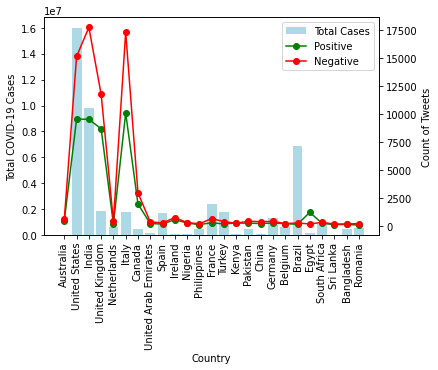

In [ ]:
df_high_counts = df_country[df_country['Total Number of Tweets'] > 250]
df_low_counts = df_country[df_country['Total Number of Tweets'] <= 250].sort_values(by=['Country'])

import matplotlib.pyplot as plt

fig, ax = plt.subplots()
ax.bar(df_high_counts['Country'], df_high_counts['total_cases'], color="#ADD8E6", label = 'Total Cases')
ax.set_xlabel('Country')
ax.set_ylabel('Total COVID-19 Cases')
plt.xticks(rotation=90)

ax2=ax.twinx()
ax2.plot(df_high_counts['Country'], df_high_counts['Count of Positive Tweets'], color="green", marker="o", label = 'Positive')
ax2.plot(df_high_counts['Country'], df_high_counts['Count of Negative Tweets'], color="red", marker="o", label = 'Negative')
ax2.set_ylabel('Count of Tweets')

fig.legend(loc="upper right", bbox_to_anchor=(1,1), bbox_transform=ax.transAxes)
plt.show()

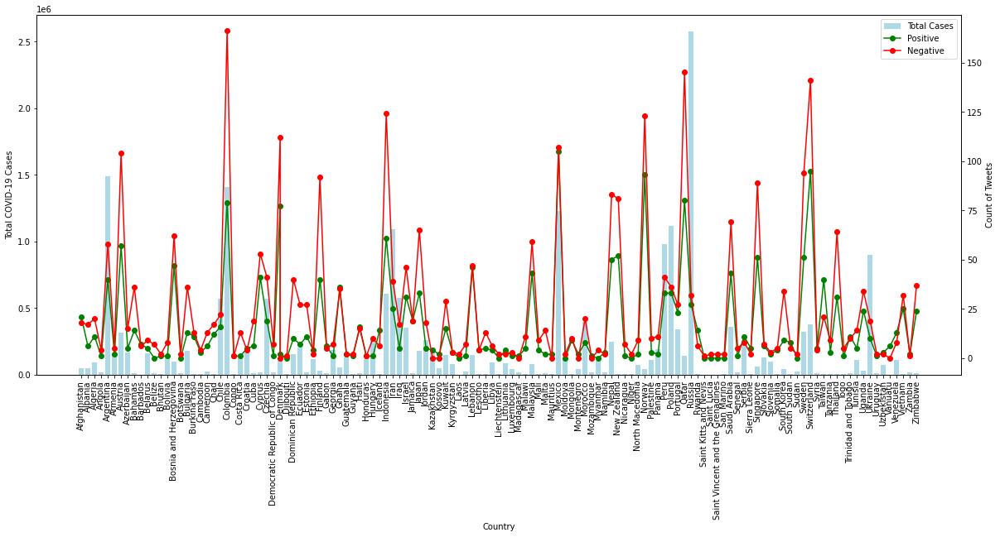

In [ ]:
fig, ax = plt.subplots()
fig.set_size_inches(20, 8)
ax.bar(df_low_counts['Country'], df_low_counts['total_cases'], color="#ADD8E6", label = 'Total Cases')

ax.set_xlabel('Country')
ax.set_ylabel('Total COVID-19 Cases')
plt.xticks(rotation=90)

ax2=ax.twinx()
ax2.plot(df_low_counts['Country'], df_low_counts['Count of Positive Tweets'], color="green", marker="o", label = 'Positive')
ax2.plot(df_low_counts['Country'], df_low_counts['Count of Negative Tweets'], color="red", marker="o", label = 'Negative')
ax2.set_ylabel('Count of Tweets')

fig.legend(loc="upper right", bbox_to_anchor=(1,1), bbox_transform=ax.transAxes)
plt.show()

### <u>ANALYZING SENTIMENTS IN DIFFERENT USA STATES AND COMPARING TO NO. OF REPORTED CASES</u>

##### GETTING STATE OF EACH TWEET FROM USA

In [ ]:
# Separating USA data

usa_vaccine_data = covid_vaccine_data[covid_vaccine_data['Country'] == 'United States']

# Getting state of each tweet

import string

def get_state(x):       
    geolocator = Nominatim(user_agent = "geoapiExercises")
    location = geolocator.geocode(x)
    a = str(location).rsplit(', ')
    a = [''.join(x for x in i if not x.isdigit()) for i in a] 
    a = [''.join(x for x in i if x not in string.punctuation) for i in a]
    a = [x for x in a if len(x) > 1]
    a = [i for i in a if i] 
    return a[-2]

locations = usa_vaccine_data['location'].unique().tolist()
states = []

for location in locations:
    try:
        states.append(get_state(location))
    except:
        states.append('State Not Recognized')
        
dict_2 = dict(zip(locations, states))
usa_vaccine_data['State'] = usa_vaccine_data['location'].map(dict_2)
usa_vaccine_data = usa_vaccine_data[usa_vaccine_data.State != 'None']
usa_vaccine_data = usa_vaccine_data[usa_vaccine_data.State != 'State Not Recognized']

usa_vaccine_data.head()

,location,tweet,Translated Tweet,Clean Tweet,Sentiment,Country,State
5,"Sacramento, CA",They can't even organize simple transportation...,They can't even organize simple transportation...,even organize simple transportation going orga...,Negative,United States,California
7,"Washington, DC",#complianceMonday Follow this link to @CDCgov ...,#complianceMonday Follow this link to @CDCgov ...,follow link ensuring safety united states,Positive,United States,District of Columbia
13,"Washington, DC",My latest in @HarvardKSR with @stevewatersco a...,My latest in @HarvardKSR with @stevewatersco a...,latest ed salsberg outlines needs national cor...,Positive,United States,District of Columbia
14,"Austin, TX",Even if the best vaccine for Covid-19 is devel...,Even if the best vaccine for Covid-19 is devel...,even best developed pretty much worthless sitt...,Negative,United States,Texas
16,"St. Louis, Missouri",Surgeon General expects #COVID19 vaccine to be...,Surgeon General expects #COVID19 vaccine to be...,surgeon general expects available end via,Negative,United States,Missouri


##### STATE ANALYSIS

In [ ]:
# Getting the total COVID-19 cases data for each country till the end date of our time frame i.e. Dec 11.

state_cases = pd.read_csv(r"C:\Users\Raheyma Arshad\Desktop\Covid Paper\Cases Data\state cases.csv")
state_cases = state_cases[state_cases['date'] == '2020-12-11']
state_cases = state_cases[['state', 'cases']]

# Getting the sentiments of states regarding the COVID-19 vaccine.

us_states = usa_vaccine_data['State'].unique().tolist()

state_positives = []
state_negatives = []

for state in us_states:
    state_tweets = usa_vaccine_data[usa_vaccine_data.State == state]
    
    state_positive = state_tweets[state_tweets['Sentiment'] == 'Positive']
    state_positives.append(len(state_positive))
    
    state_negative = state_tweets[state_tweets['Sentiment'] == 'Negative']
    state_negatives.append(len(state_negative))
    
df_us_state = pd.DataFrame({'state': us_states, 'Count of Positive Tweets': state_positives, 
                            'Count of Negative Tweets': state_negatives})

state_sentiment = []

for i in range(len(df_us_state)):
    if df_us_state['Count of Positive Tweets'][i] > df_us_state['Count of Negative Tweets'][i]:
        state_sentiment.append('Positive')
    else:
        state_sentiment.append('Negative')

df_us_state['Sentiment'] = state_sentiment

# Merging the total cases and country sentiments dataframes

df_us_state = df_us_state.merge(state_cases, on="state", how = 'inner')
df_us_state.head()

,state,Count of Positive Tweets,Count of Negative Tweets,Sentiment,cases
0,California,1243,1843,Negative,1528177
1,District of Columbia,453,614,Negative,24357
2,Texas,812,1107,Negative,1461943
3,Missouri,116,148,Negative,355147
4,Ohio,292,478,Negative,542209


In [ ]:
# Looking at sentiments of 10 states with least number of cases

df_state_sorted = df_us_state.sort_values(by=['cases'])
df_state_sorted.head(10)

,state,Count of Positive Tweets,Count of Negative Tweets,Sentiment,cases
52,Northern Mariana Islands,0,1,Negative,113
30,Vermont,17,24,Negative,5541
36,Maine,31,44,Negative,15206
22,Hawaii,23,79,Negative,19029
1,District of Columbia,453,614,Negative,24357
45,New Hampshire,40,124,Negative,29460
49,Wyoming,9,32,Negative,38785
48,Alaska,18,39,Negative,39773
42,Delaware,29,47,Negative,43818
34,West Virginia,25,36,Negative,60637


In [ ]:
# Looking at sentiments of 10 states with most number of cases

df_state_sorted.tail(10)

,state,Count of Positive Tweets,Count of Negative Tweets,Sentiment,cases
31,Michigan,146,282,Negative,459811
20,Wisconsin,129,126,Positive,461367
16,Pennsylvania,313,462,Negative,475844
33,Georgia,163,301,Negative,512715
4,Ohio,292,478,Negative,542209
10,New York,1286,1758,Negative,759765
17,Illinois,365,540,Negative,834668
9,Florida,377,952,Negative,1106388
2,Texas,812,1107,Negative,1461943
0,California,1243,1843,Negative,1528177


In [ ]:
print('The number of US States with positive sentiment are:', len(df_us_state[df_us_state.Sentiment == 'Positive']))
print('The number of US States with negative sentiment are:', len(df_us_state[df_us_state.Sentiment == 'Negative']))

The number of US States with positive sentiment are: 2
The number of US States with negative sentiment are: 51


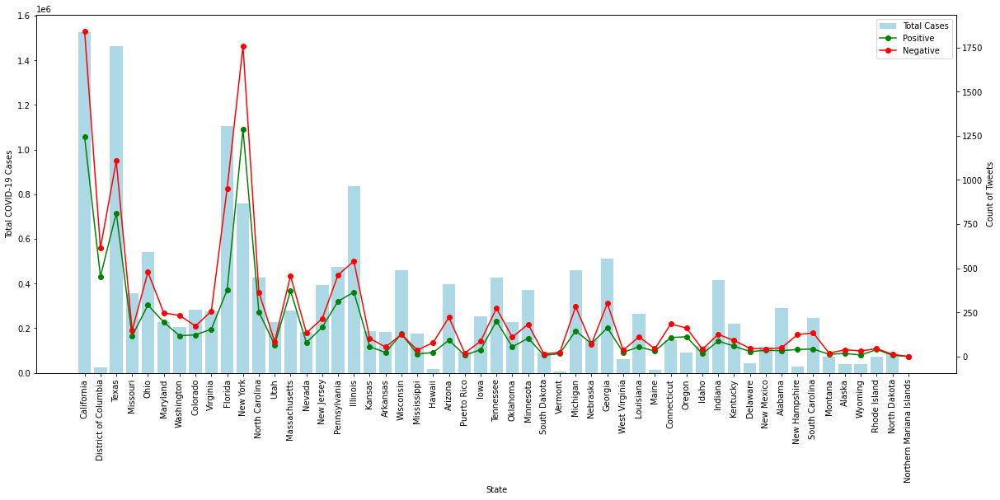

In [ ]:
fig, ax = plt.subplots()
fig.set_size_inches(20, 8)
ax.bar(df_us_state['state'], df_us_state['cases'], color="#ADD8E6", label = 'Total Cases')
ax.set_xlabel('State')
ax.set_ylabel('Total COVID-19 Cases')
plt.xticks(rotation=90)

ax2=ax.twinx()
ax2.plot(df_us_state['state'], df_us_state['Count of Positive Tweets'], color="green", marker="o", label = 'Positive')
ax2.plot(df_us_state['state'], df_us_state['Count of Negative Tweets'], color="red", marker="o", label = 'Negative')
ax2.set_ylabel('Count of Tweets')

fig.legend(loc="upper right", bbox_to_anchor=(1,1), bbox_transform=ax.transAxes)
plt.show()